# Analysis of NYC public schools results in ELA and math grades 3-8.

<span style="color: red;">**If kernel can't connect to server again run command:**
*netsh winsock reset*<span>

<a id="TOC"></a> 
## Table of Contents
1. [Data sources and definitions](#data)
2. [Imports: modules](#modules)
3. [Read and prepare data](#read)
4. [Best middle schools by math](#best)
5. [Maps of middle schools by math results](#maps) 


<a id="data"></a> 
#### Data:
1. Data New York City grades 3-8 New York State English Language Arts and Math State Tests results 2013-2023:<br>https://infohub.nyced.org/reports/academics/test-results
2. NYS schools locations:<br>
https://data.gis.ny.gov/maps/b6c624c740e4476689aa60fdc4aacb8f/about
3. Citywide or Boroughwide status:
<br>https://www.nycschoolhelp.com/borowide-citywide-middle-schools

#### Definitions of Performance Levels for the 2023 Grades 3-8 English Language Arts and Mathematics Tests  

**NYS Level 1**: Students performing at this level are below proficient in standards for their grade. They may demonstrate limited knowledge, skills, and practices embodied by the Learning Standards that are considered insufficient for the expectations at this grade. 

**NYS Level 2**: Students performing at this level are partially proficient in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered partial but insufficient for the expectations at this grade. Students performing at Level 2 are considered on track to meet current New York high school graduation requirements but are not yet proficient in Learning Standards at this grade. 

**NYS Level 3**: Students performing at this level are proficient in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered sufficient for the expectations at this grade.  

**NYS Level 4**: Students performing at this level excel in standards for their grade. They demonstrate knowledge, skills, and practices embodied by the Learning Standards that are considered more than sufficient for the expectations at this grade.  

*Source: NYSED, 2023, https://www.p12.nysed.gov/irs/ela-math/2023/ela-math-score-ranges-performance-levels-2023.pdf*

## Questions
*1. How the test results changed?*
<br>Compare last year test results in a school with the school 10-year average as percentage of average:
<br> school_change = (school_current_year - school_10year_average)/school_10year_average
<br> citywide_change = (city_current_year - city_10year_average)/city_10year_average
<br> relative_school_change = school_change - citywide_change
<br><br>
*2. How good the school is?* 
<br>Last three testing period results (2019, 2022, 2023) are different for some schools: due to COVID disruptions, testing procedures changes, in Destrict 15 due to admission rules changed. Therefore average 10 years scores do not reflect well schools situation now. Results for these 3 last testing years are teken instead.
<br><br>
*3. Is the school citywide or borowide?*
<br><br>
*4. Diversity?*
<br><br>
*5. Size?*

<a id="modules"></a> 
#### Imports: modules

In [1]:
import os
import pandas as pd
import geopandas as gpd
# import folium
# from shapely.geometry import Point
import base64
from io import BytesIO
import math
from tqdm import tqdm
from utils import match_name, create_plot, process_schools, create_chart

pd.set_option('display.float_format', '{:.3f}'.format)

C:\Users\Student\anaconda3\envs\AC37\lib\site-packages\fuzzywuzzy\fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [2]:
#To reload uitls if something changed
import utils
from importlib import reload
reload(utils)

<module 'utils' from 'G:\\My Drive\\Kids\\NYC_schools\\notebooks\\utils.py'>

<a id="read"></a> 
#### Read data

In [3]:
basePath = r"G:\My Drive\Kids\NYC_schools"
dataFolder = r"raw_data"
outputFolder = r"processed_data"

In [4]:
## Read data by schools

#Read math results
fileName_math = "school-math-results-2013-2023-(public).xlsx"
mathPath = os.path.join(basePath,dataFolder,fileName_math)
print(mathPath)
sheetName_math = "All"
mathResultsDF = pd.read_excel(mathPath, sheetName_math)

#Read ELA results
fileName_ELA = "school-ela-results-2013-2023-(public).xlsx"
ELAPath = os.path.join(basePath, dataFolder, fileName_ELA)
print(ELAPath)
sheetName_ELA = "All"
ELAResultsDF = pd.read_excel(ELAPath, sheetName_ELA)

#Read demographic file
fileName_demog = "demographic-snapshot-2018-19-to-2022-23-(public).xlsx"
demogPath = os.path.join(basePath, dataFolder, fileName_demog)
print(demogPath)
sheetName_demog = "School"
demogData = pd.read_excel(demogPath, sheetName_demog)

#Read school status file
fileName_status = "cityBoroughWideschools.csv"
statusPath = os.path.join(basePath, dataFolder, fileName_status)
print(statusPath)
statusData = pd.read_csv(statusPath)

G:\My Drive\Kids\NYC_schools\raw_data\school-math-results-2013-2023-(public).xlsx
G:\My Drive\Kids\NYC_schools\raw_data\school-ela-results-2013-2023-(public).xlsx
G:\My Drive\Kids\NYC_schools\raw_data\demographic-snapshot-2018-19-to-2022-23-(public).xlsx
G:\My Drive\Kids\NYC_schools\raw_data\cityBoroughWideschools.csv


In [5]:
subjects = ['Math', 'ELA']
resultsDFs = {'Math': mathResultsDF, 'ELA': ELAResultsDF}

In [6]:
# resultsDF.info() showed that most of the columns are objects instead of numbers and needed to be converted
for subject in subjects:
    resultsDF = resultsDFs[subject]
    resultsDF_colToConvert = ['Mean Scale Score',
     'Grade',                             
     '# Level 1',
     '% Level 1',
     '# Level 2',
     '% Level 2',
     '# Level 3',
     '% Level 3',
     '# Level 4',
     '% Level 4',
     '# Level 3+4',
     '% Level 3+4']
    resultsDF[resultsDF_colToConvert] = resultsDF[resultsDF_colToConvert].apply(pd.to_numeric, errors = 'coerce')
    resultsDF.info()
    print(len(resultsDF))
    
del resultsDF

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41918 entries, 0 to 41917
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DBN               41918 non-null  object 
 1   School Name       41918 non-null  object 
 2   Grade             32173 non-null  float64
 3   Year              41918 non-null  int64  
 4   Category          41918 non-null  object 
 5   Number Tested     41918 non-null  int64  
 6   Mean Scale Score  41559 non-null  float64
 7   # Level 1         41559 non-null  float64
 8   % Level 1         41559 non-null  float64
 9   # Level 2         41559 non-null  float64
 10  % Level 2         41559 non-null  float64
 11  # Level 3         41559 non-null  float64
 12  % Level 3         41559 non-null  float64
 13  # Level 4         41559 non-null  float64
 14  % Level 4         41559 non-null  float64
 15  # Level 3+4       41559 non-null  float64
 16  % Level 3+4       41559 non-null  float6

In [7]:
## Read citywide data

# Read math results
fileName_cityMath = "citywide-math-results-2013-2023-(public).xlsx"
cityMathPath = os.path.join(basePath,dataFolder,fileName_cityMath)
print(cityMathPath)
sheetName_cityMath = "All"
cityMathDF = pd.read_excel(cityMathPath, sheetName_cityMath)

#Read ELA results
fileName_cityELA = "citywide-ela-results-2013-2023-(public).xlsx"
cityELAPath = os.path.join(basePath, dataFolder, fileName_cityELA)
print(cityELAPath)
sheetName_cityELA = "All"
cityELADF = pd.read_excel(cityELAPath, sheetName_cityELA)

G:\My Drive\Kids\NYC_schools\raw_data\citywide-math-results-2013-2023-(public).xlsx
G:\My Drive\Kids\NYC_schools\raw_data\citywide-ela-results-2013-2023-(public).xlsx


In [8]:
cityResultsDFs = {'Math': cityMathDF, 'ELA': cityELADF}

In [9]:
cityELADF.info()
cityMathDF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63 entries, 0 to 62
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Grade             63 non-null     object 
 1   Year              63 non-null     int64  
 2   Category          63 non-null     object 
 3   Number Tested     63 non-null     int64  
 4   Mean Scale Score  63 non-null     float64
 5   # Level 1         63 non-null     int64  
 6   % Level 1         63 non-null     float64
 7   # Level 2         63 non-null     int64  
 8   % Level 2         63 non-null     float64
 9   # Level 3         63 non-null     int64  
 10  % Level 3         63 non-null     float64
 11  # Level 4         63 non-null     int64  
 12  % Level 4         63 non-null     float64
 13  # Level 3+4       63 non-null     int64  
 14  % Level 3+4       63 non-null     float64
dtypes: float64(6), int64(7), object(2)
memory usage: 7.5+ KB
<class 'pandas.core.frame.DataFrame'

In [10]:
for subject in subjects:
    resultsDF = cityResultsDFs[subject]
    resultsDF['Grade'] = resultsDF['Grade'].apply(pd.to_numeric, errors = 'coerce')
    resultsDF.info()
    print(len(resultsDF))
    
del resultsDF

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63 entries, 0 to 62
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Grade             54 non-null     float64
 1   Year              63 non-null     int64  
 2   Category          63 non-null     object 
 3   Number Tested     63 non-null     int64  
 4   Mean Scale Score  63 non-null     float64
 5   # Level 1         63 non-null     int64  
 6   % Level 1         63 non-null     float64
 7   # Level 2         63 non-null     int64  
 8   % Level 2         63 non-null     float64
 9   # Level 3         63 non-null     int64  
 10  % Level 3         63 non-null     float64
 11  # Level 4         63 non-null     int64  
 12  % Level 4         63 non-null     float64
 13  # Level 3+4       63 non-null     int64  
 14  % Level 3+4       63 non-null     float64
dtypes: float64(7), int64(7), object(1)
memory usage: 7.5+ KB
63
<class 'pandas.core.frame.DataFra

## Analysis

#### Prepare citywide dataframe with only middle school tests results (grades 6-8)

In [11]:
# Select middle school grades results from the citywide dataframes with Math and ELA tests results by year

resultsMS_Norm = {}

for subject in subjects:
        
    resultsDF = cityResultsDFs[subject]
    
    # Dataframe with only grades 6-8 results (middle schools and K-8) by years
    resultsMS = resultsDF[(resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8)]
    
    # Dataframe with results grouped by years
    resultsMS = resultsMS.groupby('Year')[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
    
    # Change column names to include subject
    resultsMS.columns = [f'Level 1 {subject}',f'Level 2 {subject}',f'Level 3 {subject}',f'Level 4 {subject}']
    
    # Dataframe for middle schools by years with normalized values
    resultsMS_Norm[subject] = resultsMS.div(resultsMS.sum(axis=1), axis=0)
    resultsMS_Norm[subject].reset_index(inplace=True)
    
    print(resultsMS_Norm[subject].head())
    
    # Dataframe with average
    
del resultsDF, resultsMS

   Year  Level 1 Math  Level 2 Math  Level 3 Math  Level 4 Math
0  2013         0.384         0.351         0.164         0.101
1  2014         0.373         0.338         0.173         0.116
2  2015         0.364         0.331         0.172         0.133
3  2016         0.351         0.325         0.166         0.157
4  2017         0.367         0.307         0.173         0.153
   Year  Level 1 ELA  Level 2 ELA  Level 3 ELA  Level 4 ELA
0  2013        0.368        0.384        0.168        0.079
1  2014        0.332        0.398        0.182        0.088
2  2015        0.324        0.372        0.205        0.098
3  2016        0.252        0.377        0.235        0.136
4  2017        0.230        0.361        0.246        0.163


In [12]:
# Get 10 years average test result

resultsMS_10y_AVG = {}

for subject in subjects:
        
    resultsDF = cityResultsDFs[subject]
    
    # Dataframe with only grades 6-8 results (middle schools and K-8) by years
    resultsMS = resultsDF[(resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8)]
    
    # Dataframe with all results summed by all years
    columns_to_sum = ['# Level 1','# Level 2','# Level 3','# Level 4']
    resultsMS = resultsMS[columns_to_sum]
    
    # Change column names to include subject
    resultsMS.columns = [f'Level 1 {subject}',f'Level 2 {subject}',f'Level 3 {subject}',f'Level 4 {subject}']
    resultsMS = resultsMS.sum() #Dataframe got converted into a series, needs fixing later

    # Change column names to include subject
    resultsMS.columns = [f'Level 1 {subject}',f'Level 2 {subject}',f'Level 3 {subject}',f'Level 4 {subject}']
    # Dataframe for middle schools grades with normalized values
    resultsMS_10y_AVG[subject] = resultsMS.div(resultsMS.sum(axis=0))
    
    # Convert the Series back into a DataFrame
    resultsMS_10y_AVG[subject] = resultsMS_10y_AVG[subject].to_frame().T # Transpose to flip rows and columns

#     resultsMS_10y_AVG[subject].reset_index(inplace=True)
    
    print(resultsMS_10y_AVG[subject].head())
    
    # Dataframe with average
    
del resultsDF, resultsMS

   Level 1 Math  Level 2 Math  Level 3 Math  Level 4 Math
0         0.363         0.298         0.184         0.156
   Level 1 ELA  Level 2 ELA  Level 3 ELA  Level 4 ELA
0        0.271        0.333        0.228        0.167


In [30]:
# Make a merged city dataframe with both Math and ELA results
DFs = list(resultsMS_10y_AVG.values())
cityAVG10yDF = pd.merge(DFs[0], DFs[1], left_index=True, right_index=True)
print(cityAVG10yDF.head())

del DFs

   Level 1 Math  Level 2 Math  Level 3 Math  Level 4 Math  Level 1 ELA  \
0         0.363         0.298         0.184         0.156        0.271   

   Level 2 ELA  Level 3 ELA  Level 4 ELA  
0        0.333        0.228        0.167  


In [31]:
cityAVG10yDF['Level 4 Math+Ela'] = cityAVG10yDF['Level 4 Math']+cityAVG10yDF['Level 4 ELA']
cityAVG10yDF.insert(0, 'Year',0)

In [32]:
cityAVG10yDF.head()

,Year,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA,Level 4 Math+Ela
0,0,0.363,0.298,0.184,0.156,0.271,0.333,0.228,0.167,0.323


In [16]:
# Make a merged city dataframe with both Math and ELA results
DFs = list(resultsMS_Norm.values())
cityResultsDF = pd.merge(DFs[0], DFs[1], on = ['Year'], how = 'inner')
print(cityResultsDF.head(11))

del DFs

   Year  Level 1 Math  Level 2 Math  Level 3 Math  Level 4 Math  Level 1 ELA  \
0  2013         0.384         0.351         0.164         0.101        0.368   
1  2014         0.373         0.338         0.173         0.116        0.332   
2  2015         0.364         0.331         0.172         0.133        0.324   
3  2016         0.351         0.325         0.166         0.157        0.252   
4  2017         0.367         0.307         0.173         0.153        0.230   
5  2018         0.360         0.260         0.189         0.191        0.236   
6  2019         0.341         0.248         0.195         0.216        0.253   
7  2022         0.424         0.249         0.159         0.167        0.201   
8  2023         0.295         0.236         0.281         0.189        0.215   

   Level 2 ELA  Level 3 ELA  Level 4 ELA  
0        0.384        0.168        0.079  
1        0.398        0.182        0.088  
2        0.372        0.205        0.098  
3        0.377        0.235

In [17]:
cityResultsDF['Level 4 Math+Ela'] = cityResultsDF['Level 4 Math']+cityResultsDF['Level 4 ELA']
cityResultsDF.head(11)

,Year,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA,Level 4 Math+Ela
0,2013,0.384,0.351,0.164,0.101,0.368,0.384,0.168,0.079,0.180
1,2014,0.373,0.338,0.173,0.116,0.332,0.398,0.182,0.088,0.205
2,2015,0.364,0.331,0.172,0.133,0.324,0.372,0.205,0.098,0.231
3,2016,0.351,0.325,0.166,0.157,0.252,0.377,0.235,0.136,0.293
4,2017,0.367,0.307,0.173,0.153,0.230,0.361,0.246,0.163,0.317
5,2018,0.360,0.260,0.189,0.191,0.236,0.289,0.249,0.225,0.416
6,2019,0.341,0.248,0.195,0.216,0.253,0.275,0.233,0.240,0.456
7,2022,0.424,0.249,0.159,0.167,0.201,0.259,0.260,0.280,0.447
8,2023,0.295,0.236,0.281,0.189,0.215,0.253,0.298,0.235,0.423


In [46]:
# Comparison = '2023 - 10 year average'
TenyAVG_2023DF = (cityResultsDF.iloc[8] - cityAVG10yDF.iloc[0])/cityAVG10yDF.iloc[0]
TenyAVG_2023DF = TenyAVG_2023DF.drop('Year')
TenyAVG_2023DF

Level 1 Math       -0.188
Level 2 Math       -0.208
Level 3 Math        0.529
Level 4 Math        0.212
Level 1 ELA        -0.209
Level 2 ELA        -0.241
Level 3 ELA         0.305
Level 4 ELA         0.402
Level 4 Math+Ela    0.310
dtype: float64

#### Prepare schools dataframe with only middle school tests results (grades 6-8)

In [5]:
# Select middle school grades results from the dataframes with Math and ELA tests results

resultsMS_bySchl_Norm ={}

for subject in subjects:
    
    
    resultsDF = resultsDFs[subject]
    
    # Dataframe with only grades 6-8 results (middle schools and K-8) by years
    resultsMS_bySchl = resultsDF[(resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8)]
    resultsMS_bySchl = resultsMS_bySchl.groupby(['DBN', 'School Name', 'Year'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
    
    # Change column names to include subject
    resultsMS_bySchl.columns = [f'Level 1 {subject}',f'Level 2 {subject}',f'Level 3 {subject}',f'Level 4 {subject}']
    
    # Dataframe for middle schools by years with normalized values
    resultsMS_bySchl_Norm[subject] = resultsMS_bySchl.div(resultsMS_bySchl.sum(axis=1), axis=0)
    resultsMS_bySchl_Norm[subject].reset_index(inplace=True)
    
    print(resultsMS_bySchl_Norm[subject].head())
    
del resultsDF, resultsMS_bySchl

      DBN                     School Name  Year  Level 1 Math  Level 2 Math  \
0  01M015       P.S. 015 ROBERTO CLEMENTE  2023           NaN           NaN   
1  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2013         0.302         0.416   
2  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2014         0.336         0.375   
3  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2015         0.361         0.392   
4  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2016         0.420         0.408   

   Level 3 Math  Level 4 Math  
0           NaN           NaN  
1         0.195         0.087  
2         0.230         0.059  
3         0.190         0.057  
4         0.127         0.045  
      DBN                     School Name  Year  Level 1 ELA  Level 2 ELA  \
0  01M015       P.S. 015 ROBERTO CLEMENTE  2023          NaN          NaN   
1  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2013        0.366        0.524   
2  01M034  P.S. 034 FRANKLIN D. ROOSEVELT  2014        0.301        0.477   
3  01M034  P.S. 034 FRANK

In [6]:
# Make a merged dataframe with both Math and ELA results
DFs = list(resultsMS_bySchl_Norm.values())
allResultsDF = pd.merge(DFs[0], DFs[1], on = ['DBN', 'Year'], how = 'inner')
allResultsDF.head(5)

,DBN,School Name_x,Year,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,School Name_y,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA
0,01M015,P.S. 015 ROBERTO CLEMENTE,2023,NaN,NaN,NaN,NaN,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2013,0.302,0.416,0.195,0.087,P.S. 034 FRANKLIN D. ROOSEVELT,0.366,0.524,0.097,0.014
2,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2014,0.336,0.375,0.230,0.059,P.S. 034 FRANKLIN D. ROOSEVELT,0.301,0.477,0.176,0.046
3,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2015,0.361,0.392,0.190,0.057,P.S. 034 FRANKLIN D. ROOSEVELT,0.250,0.461,0.250,0.039
4,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2016,0.420,0.408,0.127,0.045,P.S. 034 FRANKLIN D. ROOSEVELT,0.237,0.481,0.231,0.051


In [7]:
# Add colomn with sum of shares of level4 students by Math and level4 students ELa
allResultsDF['Level 4 Math+Ela'] = allResultsDF[f'Level 4 {subjects[0]}']+allResultsDF[f'Level 4 {subjects[1]}']
allResultsDF.head(10)

,DBN,School Name_x,Year,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,School Name_y,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA,Level 4 Math+Ela
0,01M015,P.S. 015 ROBERTO CLEMENTE,2023,NaN,NaN,NaN,NaN,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2013,0.302,0.416,0.195,0.087,P.S. 034 FRANKLIN D. ROOSEVELT,0.366,0.524,0.097,0.014,0.101
2,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2014,0.336,0.375,0.230,0.059,P.S. 034 FRANKLIN D. ROOSEVELT,0.301,0.477,0.176,0.046,0.105
3,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2015,0.361,0.392,0.190,0.057,P.S. 034 FRANKLIN D. ROOSEVELT,0.250,0.461,0.250,0.039,0.096
4,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2016,0.420,0.408,0.127,0.045,P.S. 034 FRANKLIN D. ROOSEVELT,0.237,0.481,0.231,0.051,0.096
5,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2017,0.412,0.420,0.137,0.031,P.S. 034 FRANKLIN D. ROOSEVELT,0.187,0.511,0.245,0.058,0.088
6,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2018,0.580,0.277,0.092,0.050,P.S. 034 FRANKLIN D. ROOSEVELT,0.284,0.414,0.172,0.129,0.180
7,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2019,0.524,0.311,0.146,0.019,P.S. 034 FRANKLIN D. ROOSEVELT,0.393,0.402,0.121,0.084,0.104
8,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2022,0.738,0.154,0.092,0.015,P.S. 034 FRANKLIN D. ROOSEVELT,0.337,0.421,0.147,0.095,0.110
9,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2023,0.366,0.366,0.220,0.049,P.S. 034 FRANKLIN D. ROOSEVELT,0.241,0.430,0.241,0.089,0.137


#### Select schools with the best results for all middle school grades in 2023

In [48]:
del comparison2023_10yAVG

In [49]:
allSchools2023 = allResultsDF[(allResultsDF['Year'] == 2023)]
allSchools2023.head()

,DBN,School Name_x,Year,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,School Name_y,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA,Level 4 Math+Ela
0,01M015,P.S. 015 ROBERTO CLEMENTE,2023,NaN,NaN,NaN,NaN,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN
9,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,2023,0.366,0.366,0.220,0.049,P.S. 034 FRANKLIN D. ROOSEVELT,0.241,0.430,0.241,0.089,0.137
18,01M140,P.S. 140 NATHAN STRAUS,2023,0.401,0.241,0.292,0.066,P.S. 140 NATHAN STRAUS,0.290,0.331,0.298,0.081,0.146
27,01M184,P.S. 184M SHUANG WEN,2023,0.030,0.030,0.283,0.657,P.S. 184M SHUANG WEN,0.020,0.123,0.308,0.549,1.206
36,01M188,P.S. 188 THE ISLAND SCHOOL,2023,0.175,0.351,0.368,0.105,P.S. 188 THE ISLAND SCHOOL,0.122,0.397,0.321,0.160,0.266


#### Create dataframe with average 2013-2023 math and ela test results for all middle school grades

In [8]:
# Make a merged dataframe with both Math and ELA average 2013-2023 results 

# Select top 50 schools by average test results 2013-2023 by subjects

resultsMS_top50_AVG2013_23 = {}
resultsMS_AVG2013_23 = {}

for subject in subjects:
    
    resultsDF = resultsDFs[subject]
    
    # Dataframe with only grades 6-8 results (middle schools and K-8) by schools
    resultsMS_bySchl_sumed = resultsDF[(resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8)].groupby(['DBN', 'School Name'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
    # Rename columns
    resultsMS_bySchl_sumed.columns = [f'# Level 1 {subject}',f'# Level 2 {subject}',f'# Level 3 {subject}',f'# Level 4 {subject}']

    
    # Dataframe for middle schools by years with normalized values
    resultsMS_bySchl_sumed_Norm = resultsMS_bySchl_sumed.div(resultsMS_bySchl_sumed.sum(axis=1), axis=0)
    resultsMS_bySchl_sumed_Norm.columns = [f'10yrs avg Lvl 1 {subject}',f'10yrs avg Lvl 2 {subject}',f'10yrs avg Lvl 3 {subject}',f'10yrs avg Lvl 4 {subject}']
#     resultsMS_bySchl_sumed_sorted = resultsMS_bySchl_sumed_Norm.sort_values(by = f'10yrs avg Lvl 4 {subject}', ascending=False)
    
#     resultsMS_bySchl_sumed_sorted.reset_index(inplace=True)
    resultsMS_bySchl_sumed_Norm.reset_index(inplace = True)
    # Add the dataframe to the respective dictionnary 
    resultsMS_AVG2013_23[subject] = resultsMS_bySchl_sumed_Norm
    print(len(resultsMS_AVG2013_23[subject]))
    
#     resultsMS_top50_AVG2013_23[subject] = resultsMS_bySchl_sumed_sorted.head(50)
#     print(resultsMS_bySchl_sumed_sorted.head(10))
#     fileName = f'50_schools_with_highest_level4_share_{subject}2013-2023.csv'
#     filePath = os.path.join(basePath, outputFolder, fileName)
#     resultsMS_bySchl_sumed_sorted.head(50).to_csv(filePath, index = True)

# del resultsDF, resultsMS_bySchl_sumed_Norm, resultsMS_bySchl_sumed_sorted, fileName, filePath, resultsMS_bySchl_sumed
del resultsDF, resultsMS_bySchl_sumed_Norm, resultsMS_bySchl_sumed

526
526


In [9]:
# Make a merged dataframe with both Math and ELA average 2013-2023 results 

## Select top 50 schools by average 2013-2023 sum of level 4 resuts by math and ELA

AVG2013_23_DFs = list(resultsMS_AVG2013_23.values())
allResultsAVG2013_23DF = pd.merge(AVG2013_23_DFs[0], AVG2013_23_DFs[1], on = ['DBN','School Name'], how = 'inner')
allResultsAVG2013_23DF['10yrs avg Lvl 4 Math+Ela'] = allResultsAVG2013_23DF[f'10yrs avg Lvl 4 {subjects[0]}']+allResultsAVG2013_23DF[f'10yrs avg Lvl 4 {subjects[1]}']
# allResultsAVG2013_23DF_sorted = allResultsAVG2013_23DF_norm.sort_values('Level 4 Math+Ela', ascending= False)
# allResultsAVG2013_23DF_sorted.head(50)
# AVG2013_23Name = '50_schools_with_highest_level4_share_MathEla2013-23.csv'
# AVG2013_23Path = os.path.join(basePath, outputFolder, AVG2013_23Name)
# allResultsAVG2013_23DF_sorted.head(50).to_csv(AVG2013_23Path, index=True)

# del AVG2013_23_DFs, allResultsAVG2013_23DF_norm_sorted, AVG2013_23Name, AVG2013_23Path
del AVG2013_23_DFs

In [10]:
allResultsAVG2013_23DF.head()

,DBN,School Name,10yrs avg Lvl 1 Math,10yrs avg Lvl 2 Math,10yrs avg Lvl 3 Math,10yrs avg Lvl 4 Math,10yrs avg Lvl 1 ELA,10yrs avg Lvl 2 ELA,10yrs avg Lvl 3 ELA,10yrs avg Lvl 4 ELA,10yrs avg Lvl 4 Math+Ela
0,01M015,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,0.427,0.363,0.161,0.049,0.285,0.464,0.188,0.062,0.111
2,01M140,P.S. 140 NATHAN STRAUS,0.483,0.338,0.141,0.038,0.331,0.430,0.183,0.056,0.095
3,01M184,P.S. 184M SHUANG WEN,0.060,0.125,0.246,0.569,0.060,0.178,0.337,0.425,0.994
4,01M188,P.S. 188 THE ISLAND SCHOOL,0.330,0.438,0.164,0.068,0.342,0.440,0.178,0.040,0.108


In [50]:
allResultsAVG2013_23DF = allResultsAVG2013_23DF.merge(allSchools2023, left_on = 'School Name', right_on = 'School Name_x')
allResultsAVG2013_23DF.head()

,DBN_x,School Name,10yrs avg Lvl 1 Math,10yrs avg Lvl 2 Math,10yrs avg Lvl 3 Math,10yrs avg Lvl 4 Math,10yrs avg Lvl 1 ELA,10yrs avg Lvl 2 ELA,10yrs avg Lvl 3 ELA,10yrs avg Lvl 4 ELA,...,Level 1 Math,Level 2 Math,Level 3 Math,Level 4 Math,School Name_y,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA,Level 4 Math+Ela
0,01M015,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,0.427,0.363,0.161,0.049,0.285,0.464,0.188,0.062,...,0.366,0.366,0.220,0.049,P.S. 034 FRANKLIN D. ROOSEVELT,0.241,0.430,0.241,0.089,0.137
2,01M140,P.S. 140 NATHAN STRAUS,0.483,0.338,0.141,0.038,0.331,0.430,0.183,0.056,...,0.401,0.241,0.292,0.066,P.S. 140 NATHAN STRAUS,0.290,0.331,0.298,0.081,0.146
3,01M184,P.S. 184M SHUANG WEN,0.060,0.125,0.246,0.569,0.060,0.178,0.337,0.425,...,0.030,0.030,0.283,0.657,P.S. 184M SHUANG WEN,0.020,0.123,0.308,0.549,1.206
4,01M188,P.S. 188 THE ISLAND SCHOOL,0.330,0.438,0.164,0.068,0.342,0.440,0.178,0.040,...,0.175,0.351,0.368,0.105,P.S. 188 THE ISLAND SCHOOL,0.122,0.397,0.321,0.160,0.266


In [54]:
allResultsAVG2013_23DF['2023-10yAVG'] = (allResultsAVG2013_23DF['Level 4 Math+Ela'] - allResultsAVG2013_23DF['10yrs avg Lvl 4 Math+Ela'])/allResultsAVG2013_23DF['10yrs avg Lvl 4 Math+Ela']
allResultsAVG2013_23DF['10yAVG(school-city)'] = allResultsAVG2013_23DF['2023-10yAVG'] - TenyAVG_2023DF['Level 4 Math+Ela']
allResultsAVG2013_23DF.head()

,DBN_x,School Name,10yrs avg Lvl 1 Math,10yrs avg Lvl 2 Math,10yrs avg Lvl 3 Math,10yrs avg Lvl 4 Math,10yrs avg Lvl 1 ELA,10yrs avg Lvl 2 ELA,10yrs avg Lvl 3 ELA,10yrs avg Lvl 4 ELA,...,Level 3 Math,Level 4 Math,School Name_y,Level 1 ELA,Level 2 ELA,Level 3 ELA,Level 4 ELA,Level 4 Math+Ela,2023-10yAVG,10yAVG(school-city)
0,01M015,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,0.427,0.363,0.161,0.049,0.285,0.464,0.188,0.062,...,0.220,0.049,P.S. 034 FRANKLIN D. ROOSEVELT,0.241,0.430,0.241,0.089,0.137,0.232,-0.078
2,01M140,P.S. 140 NATHAN STRAUS,0.483,0.338,0.141,0.038,0.331,0.430,0.183,0.056,...,0.292,0.066,P.S. 140 NATHAN STRAUS,0.290,0.331,0.298,0.081,0.146,0.547,0.237
3,01M184,P.S. 184M SHUANG WEN,0.060,0.125,0.246,0.569,0.060,0.178,0.337,0.425,...,0.283,0.657,P.S. 184M SHUANG WEN,0.020,0.123,0.308,0.549,1.206,0.213,-0.097
4,01M188,P.S. 188 THE ISLAND SCHOOL,0.330,0.438,0.164,0.068,0.342,0.440,0.178,0.040,...,0.368,0.105,P.S. 188 THE ISLAND SCHOOL,0.122,0.397,0.321,0.160,0.266,1.464,1.153


In [55]:
allResultsAVG2013_23DF.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 483 entries, 0 to 482
Data columns (total 26 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   DBN_x                     483 non-null    object 
 1   School Name               483 non-null    object 
 2   10yrs avg Lvl 1 Math      479 non-null    float64
 3   10yrs avg Lvl 2 Math      479 non-null    float64
 4   10yrs avg Lvl 3 Math      479 non-null    float64
 5   10yrs avg Lvl 4 Math      479 non-null    float64
 6   10yrs avg Lvl 1 ELA       479 non-null    float64
 7   10yrs avg Lvl 2 ELA       479 non-null    float64
 8   10yrs avg Lvl 3 ELA       479 non-null    float64
 9   10yrs avg Lvl 4 ELA       479 non-null    float64
 10  10yrs avg Lvl 4 Math+Ela  479 non-null    float64
 11  DBN_y                     483 non-null    object 
 12  School Name_x             483 non-null    object 
 13  Year                      483 non-null    int64  
 14  Level 1 Ma

#### Create dataframe with average 2019-2023 (last 3 tests) math and ela test results for all middle school grades

In [56]:
# Make a merged dataframe with both Math and ELA average 2019-2023 results 

# Select top 50 schools by average test results 2019-2023 by subjects

resultsMS_top50_AVG2019_23 = {}
resultsMS_AVG2019_23 = {}

for subject in subjects:
    
    resultsDF = resultsDFs[subject]
    
    # Dataframe with only grades 6-8 results (middle schools and K-8) by schools
    resultsMS_bySchl_sumed = resultsDF[((resultsDF['Grade'] >= 6)&(resultsDF['Grade'] <= 8))&(resultsDF['Year'] >= 2019)].groupby(['DBN', 'School Name'])[['# Level 1','# Level 2','# Level 3','# Level 4']].sum()
    # Rename columns
    resultsMS_bySchl_sumed.columns = [f'# Level 1 {subject}',f'# Level 2 {subject}',f'# Level 3 {subject}',f'# Level 4 {subject}']

    
    # Dataframe for middle schools by years with normalized values
    resultsMS_bySchl_sumed_Norm = resultsMS_bySchl_sumed.div(resultsMS_bySchl_sumed.sum(axis=1), axis=0)
    resultsMS_bySchl_sumed_Norm.columns = [f'3yrs avg Lvl 1 {subject}',f'3yrs avg Lvl 2 {subject}',f'3yrs avg Lvl 3 {subject}',f'3yrs avg Lvl 4 {subject}']
#     resultsMS_bySchl_sumed_sorted = resultsMS_bySchl_sumed_Norm.sort_values(by = f'4yrs avg Lvl 4 {subject}', ascending=False)
    
#     resultsMS_bySchl_sumed_sorted.reset_index(inplace=True)
    resultsMS_bySchl_sumed_Norm.reset_index(inplace = True)
    
    # Add the dataframe to the respective dictionnary     
    resultsMS_AVG2019_23[subject] = resultsMS_bySchl_sumed_Norm
    print(len(resultsMS_AVG2019_23[subject]))
    
#     resultsMS_top50_AVG2019_23[subject] = resultsMS_bySchl_sumed_sorted.head(50)
#     print(resultsMS_bySchl_sumed_sorted.head(10))
#     fileName = f'50_schools_with_highest_level4_share_{subject}2019-2023.csv'
#     filePath = os.path.join(basePath, outputFolder, fileName)
#     resultsMS_bySchl_sumed_sorted.head(50).to_csv(filePath, index = True)

# del resultsDF, resultsMS_bySchl_sumed_Norm, resultsMS_bySchl_sumed_sorted, fileName, filePath, resultsMS_bySchl_sumed
del resultsDF, resultsMS_bySchl_sumed_Norm, resultsMS_bySchl_sumed

496
496


In [57]:
# Make a merged dataframe with both Math and ELA average 2019-2023 results 

## Select top 50 schools by average 2019-2023 sum of level 4 resuts by math and ELA

AVG2019_23_DFs = list(resultsMS_AVG2019_23.values())
allResultsAVG2019_23DF = pd.merge(AVG2019_23_DFs[0], AVG2019_23_DFs[1], on = ['DBN','School Name'], how = 'inner')
allResultsAVG2019_23DF['3yrs avg Lvl 4 Math+Ela'] = allResultsAVG2019_23DF[f'3yrs avg Lvl 4 {subjects[0]}']+allResultsAVG2019_23DF[f'3yrs avg Lvl 4 {subjects[1]}']
# allResultsAVG2019_23DF_sorted = allResultsAVG2019_23DF_norm.sort_values('3yrs avg Lvl 4 Math+Ela', ascending= False)
# allResultsAVG2019_23DF_sorted.head(50)
# AVG2019_23Name = '50_schools_with_highest_level4_share_MathEla2013-23.csv'
# AVG2019_23Path = os.path.join(basePath, outputFolder, AVG2013_23Name)
# allResultsAVG2019_23DF_sorted.head(50).to_csv(AVG2019_23Path, index=True)

# del AVG2019_23_DFs, allResultsAVG2019_23DF_norm_sorted, AVG2019_23Name, AVG2019_23Path
del AVG2019_23_DFs

In [58]:
allResultsAVG2019_23DF.head()

,DBN,School Name,3yrs avg Lvl 1 Math,3yrs avg Lvl 2 Math,3yrs avg Lvl 3 Math,3yrs avg Lvl 4 Math,3yrs avg Lvl 1 ELA,3yrs avg Lvl 2 ELA,3yrs avg Lvl 3 ELA,3yrs avg Lvl 4 ELA,3yrs avg Lvl 4 Math+Ela
0,01M015,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,0.560,0.273,0.144,0.024,0.331,0.416,0.164,0.089,0.113
2,01M140,P.S. 140 NATHAN STRAUS,0.496,0.273,0.176,0.055,0.300,0.353,0.245,0.103,0.158
3,01M184,P.S. 184M SHUANG WEN,0.062,0.110,0.231,0.597,0.063,0.130,0.285,0.522,1.119
4,01M188,P.S. 188 THE ISLAND SCHOOL,0.248,0.424,0.265,0.063,0.214,0.441,0.277,0.067,0.130


#### Create final dataframe with data for analysis

In [94]:
# Merge dataframes with average 10 years and last 3 tests results
schoolsAllData = pd.merge(allResultsAVG2013_23DF, allResultsAVG2019_23DF, left_on = ['DBN_x', 'School Name'], right_on = ['DBN', 'School Name'], how = 'inner')
schoolsAllData.head()

,DBN_x,School Name,10yrs avg Lvl 1 Math,10yrs avg Lvl 2 Math,10yrs avg Lvl 3 Math,10yrs avg Lvl 4 Math,10yrs avg Lvl 1 ELA,10yrs avg Lvl 2 ELA,10yrs avg Lvl 3 ELA,10yrs avg Lvl 4 ELA,...,DBN,3yrs avg Lvl 1 Math,3yrs avg Lvl 2 Math,3yrs avg Lvl 3 Math,3yrs avg Lvl 4 Math,3yrs avg Lvl 1 ELA,3yrs avg Lvl 2 ELA,3yrs avg Lvl 3 ELA,3yrs avg Lvl 4 ELA,3yrs avg Lvl 4 Math+Ela
0,01M015,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,01M015,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,0.427,0.363,0.161,0.049,0.285,0.464,0.188,0.062,...,01M034,0.560,0.273,0.144,0.024,0.331,0.416,0.164,0.089,0.113
2,01M140,P.S. 140 NATHAN STRAUS,0.483,0.338,0.141,0.038,0.331,0.430,0.183,0.056,...,01M140,0.496,0.273,0.176,0.055,0.300,0.353,0.245,0.103,0.158
3,01M184,P.S. 184M SHUANG WEN,0.060,0.125,0.246,0.569,0.060,0.178,0.337,0.425,...,01M184,0.062,0.110,0.231,0.597,0.063,0.130,0.285,0.522,1.119
4,01M188,P.S. 188 THE ISLAND SCHOOL,0.330,0.438,0.164,0.068,0.342,0.440,0.178,0.040,...,01M188,0.248,0.424,0.265,0.063,0.214,0.441,0.277,0.067,0.130


In [61]:
len(allResultsAVG2019_23DF)

494

### Addting school status (citywide, boroughwide) to the dataframe with all tests resuls

In [95]:
demogData.columns = [col.replace('/', '_') for col in demogData.columns]

In [96]:
# Selecting the columns needed for analysis from demography data

cols = ['DBN', 'Year', 'Total Enrollment', '% Asian', '% Black', '% Hispanic', '% Multi-Racial', '% Native American', '% White', '% Missing Race_Ethnicity Data']
diversityData = demogData[cols]
index = diversityData['Year'] == '2022-23'
diversityData = diversityData[index]

In [97]:
len(diversityData)

1890

In [98]:
# Merging the school diversity data and school status data

diversityStatusData = pd.merge(diversityData, statusData, on = 'DBN', how = 'outer')
len(diversityStatusData)

1890

In [99]:
# Merging schools data for analysis with demographic and status data
schoolsAllData = schoolsAllData.merge(diversityStatusData, on = 'DBN', how = 'inner')
len(schoolsAllData)

C:\Users\Student\anaconda3\envs\AC37\lib\site-packages\pandas\core\frame.py:9203: FutureWarning: Passing 'suffixes' which cause duplicate columns {'School Name_x'} in the result is deprecated and will raise a MergeError in a future version.
  validate=validate,


483

In [100]:
schoolsAllData.tail()

,DBN_x,School Name_x,10yrs avg Lvl 1 Math,10yrs avg Lvl 2 Math,10yrs avg Lvl 3 Math,10yrs avg Lvl 4 Math,10yrs avg Lvl 1 ELA,10yrs avg Lvl 2 ELA,10yrs avg Lvl 3 ELA,10yrs avg Lvl 4 ELA,...,% Asian,% Black,% Hispanic,% Multi-Racial,% Native American,% White,% Missing Race_Ethnicity Data,School Name_y,Open to,Comments
478,32K349,"I.S. 349 MATH, SCIENCE & TECH.",0.515,0.340,0.107,0.038,0.420,0.388,0.146,0.045,...,0.024,0.092,0.843,0.000,0.012,0.028,0.000,"IS 349 Math, Science & Tech",Brooklyn,NaN
479,32K383,J.H.S. 383 PHILIPPA SCHUYLER,0.239,0.410,0.254,0.098,0.111,0.338,0.351,0.200,...,0.023,0.278,0.654,0.005,0.004,0.024,0.012,JHS 383 Philippa Schuyler,Brooklyn,course grades
480,32K384,P.S. /I.S. 384 FRANCES E. CARTER,0.475,0.362,0.136,0.027,0.306,0.408,0.218,0.068,...,0.006,0.151,0.829,0.000,0.000,0.014,0.000,NaN,NaN,NaN
481,32K554,ALL CITY LEADERSHIP SECONDARY SCHOOL,0.058,0.179,0.376,0.387,0.036,0.180,0.362,0.422,...,0.055,0.116,0.660,0.005,0.005,0.116,0.043,All City Leadership Secondary School,Brooklyn,course grades
482,32K562,EVERGREEN MIDDLE SCHOOL FOR URBAN EXPLORATION,0.622,0.273,0.082,0.023,0.424,0.381,0.153,0.043,...,0.006,0.157,0.805,0.003,0.000,0.020,0.009,Evergreen Middle School for Urban Exploration,Brooklyn,NaN


In [78]:
len(schoolsAllData)

483

In [103]:
schoolsAllData_short = schoolsAllData[['DBN_x', 'School Name_x', 'Year_x', '2023-10yAVG', '10yAVG(school-city)', '3yrs avg Lvl 4 Math+Ela', 'Year_y', 'School Name_y', 'Open to', 'Comments']]
schoolsAllData_short

,DBN_x,School Name_x,School Name_x,Year_x,2023-10yAVG,10yAVG(school-city),3yrs avg Lvl 4 Math+Ela,Year_y,School Name_y,School Name_y,Open to,Comments
0,01M015,P.S. 015 ROBERTO CLEMENTE,P.S. 015 ROBERTO CLEMENTE,2023,NaN,NaN,NaN,2022-23,P.S. 015 ROBERTO CLEMENTE,NaN,NaN,NaN
1,01M034,P.S. 034 FRANKLIN D. ROOSEVELT,P.S. 034 FRANKLIN D. ROOSEVELT,2023,0.232,-0.078,0.113,2022-23,P.S. 034 FRANKLIN D. ROOSEVELT,NaN,NaN,NaN
2,01M140,P.S. 140 NATHAN STRAUS,P.S. 140 NATHAN STRAUS,2023,0.547,0.237,0.158,2022-23,P.S. 140 NATHAN STRAUS,NaN,NaN,NaN
3,01M184,P.S. 184M SHUANG WEN,P.S. 184M SHUANG WEN,2023,0.213,-0.097,1.119,2022-23,P.S. 184M SHUANG WEN,NaN,NaN,NaN
4,01M188,P.S. 188 THE ISLAND SCHOOL,P.S. 188 THE ISLAND SCHOOL,2023,1.464,1.153,0.130,2022-23,P.S. 188 THE ISLAND SCHOOL,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
478,32K349,"I.S. 349 MATH, SCIENCE & TECH.","I.S. 349 MATH, SCIENCE & TECH.",2023,1.114,0.804,0.191,2022-23,"I.S. 349 MATH, SCIENCE & TECH.","IS 349 Math, Science & Tech",Brooklyn,NaN
479,32K383,J.H.S. 383 PHILIPPA SCHUYLER,J.H.S. 383 PHILIPPA SCHUYLER,2023,0.155,-0.155,0.374,2022-23,J.H.S. 383 PHILIPPA SCHUYLER,JHS 383 Philippa Schuyler,Brooklyn,course grades
480,32K384,P.S. /I.S. 384 FRANCES E. CARTER,P.S. /I.S. 384 FRANCES E. CARTER,2023,0.189,-0.121,0.103,2022-23,P.S. /I.S. 384 FRANCES E. CARTER,NaN,NaN,NaN
481,32K554,ALL CITY LEADERSHIP SECONDARY SCHOOL,ALL CITY LEADERSHIP SECONDARY SCHOOL,2023,-0.207,-0.517,1.009,2022-23,ALL CITY LEADERSHIP SECONDARY SCHOOL,All City Leadership Secondary School,Brooklyn,course grades


In [101]:
schoolsAllData.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 483 entries, 0 to 482
Data columns (total 48 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   DBN_x                          483 non-null    object 
 1   School Name_x                  483 non-null    object 
 2   10yrs avg Lvl 1 Math           479 non-null    float64
 3   10yrs avg Lvl 2 Math           479 non-null    float64
 4   10yrs avg Lvl 3 Math           479 non-null    float64
 5   10yrs avg Lvl 4 Math           479 non-null    float64
 6   10yrs avg Lvl 1 ELA            479 non-null    float64
 7   10yrs avg Lvl 2 ELA            479 non-null    float64
 8   10yrs avg Lvl 3 ELA            479 non-null    float64
 9   10yrs avg Lvl 4 ELA            479 non-null    float64
 10  10yrs avg Lvl 4 Math+Ela       479 non-null    float64
 11  DBN_y                          483 non-null    object 
 12  School Name_x                  483 non-null    obj

<a id="maps"></a> 
### Preparing geoJSONs for mapping

#### Read schools geolocation file

In [87]:
## Read GeoJSON into data frame
SchoolsFile = 'NYC_K-12_schools_public.geojson'
NYCSchoolsPath = os.path.join(basePath, dataFolder, SchoolsFile)
NYCSchoolsData = gpd.read_file(NYCSchoolsPath)

DistrictsFile = 'School Districts.geojson'
NYCDistrictsPath = os.path.join(basePath, dataFolder, DistrictsFile)
NYCDistrictsData = gpd.read_file(NYCDistrictsPath)

#### Merge the GeoJSON and the results dataframe

In [88]:
#NYCSchoolsData.info() #Too many columns --> make a smaller copy
NYCSchoolsDataShort = NYCSchoolsData[['OBJECTID', 'LEGAL_NAME', 'PHYSADDRLINE1', 'PHYSCITY', 'COUNTY_DESC', 'RECORD_TYPE_DESC', 'SDL_DESC', 'geometry']]
NYCSchoolsDataShort.head()

,OBJECTID,LEGAL_NAME,PHYSADDRLINE1,PHYSCITY,COUNTY_DESC,RECORD_TYPE_DESC,SDL_DESC,geometry
0,54,PS 11 THOMAS DONGAN SCHOOL,85 GARRETSON AVE,STATEN ISLAND,RICHMOND,PUBLIC SCHOOL (IMF),NYC GEOG DIST 31,POINT (576322.056 4493696.890)
1,55,SCHOOL WITHOUT WALLS,207 TRINITY PL,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 2,POINT (583425.686 4506914.562)
2,131,YOUNG WOMEN'S LEADERSHIP SCHOOL,140 W 140TH ST,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 4,POINT (589347.579 4519091.922)
3,132,EDWARD A REYNOLDS WEST SIDE HIGH SCHOOL,105 E 106TH ST,NEW YORK,NEW YORK,PUBLIC SCHOOL (IMF),NYC GEOG DIST 3,POINT (588814.806 4516292.893)
4,134,ASPIRATIONS DIPLOMA PLUS HIGH SCHOOL,1150 E NEW YORK AVE,BROOKLYN,KINGS,PUBLIC SCHOOL (IMF),NYC GEOG DIST 17,POINT (590940.002 4502277.994)


In [89]:
# Matching the school all data file with spatial data (geojson of schools locations)

# Matching names from resultsMS_bySchl_Norm[subject] to NYCSchoolsDataShort
schoolsAllData['matched_name'] = schoolsAllData['School Name_x'].apply(lambda x: match_name(x, NYCSchoolsDataShort['LEGAL_NAME'], min_score=80))

# Merging DataFrames based on the matched name
schoolsAllData_mappable = pd.merge(NYCSchoolsDataShort,schoolsAllData, left_on='LEGAL_NAME', right_on='matched_name')
allData_Name = 'NYCpublicSchoolsAllData.geojson'
allData_Path = os.path.join(basePath,outputFolder, allData_Name)
schoolsAllData_mappable.to_file(allData_Path, driver="GeoJSON")

del allData_Name, allData_Path

TypeError: expected string or bytes-like object

In [26]:
# allResultsAVG2013_23DF_norm.reset_index()
schoolsAllData_mappable.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 472 entries, 0 to 471
Data columns (total 41 columns):
 #   Column                         Non-Null Count  Dtype   
---  ------                         --------------  -----   
 0   OBJECTID                       472 non-null    int64   
 1   LEGAL_NAME                     472 non-null    object  
 2   PHYSADDRLINE1                  472 non-null    object  
 3   PHYSCITY                       472 non-null    object  
 4   COUNTY_DESC                    472 non-null    object  
 5   RECORD_TYPE_DESC               472 non-null    object  
 6   SDL_DESC                       472 non-null    object  
 7   geometry                       472 non-null    geometry
 8   DBN                            472 non-null    object  
 9   School Name_x                  472 non-null    object  
 10  10yrs avg Lvl 1 Math           464 non-null    float64 
 11  10yrs avg Lvl 2 Math           464 non-null    float64 
 12  10yrs avg Lvl 3 Math        

In [27]:
print(schoolsAllData_mappable['matched_name'].isnull().sum())

0


### Add history ELA/math results, diversity data as plots to the geodata frame and saving into GeoJSON file

G:\My Drive\Kids\NYC_schools\notebooks\utils.py:60: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(3, 6))  # 1 inches wide, 1 inches tall


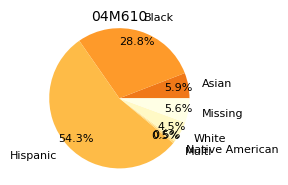

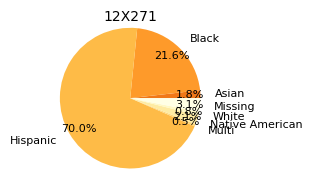

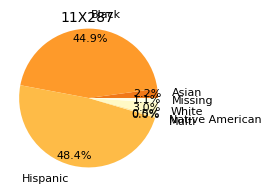

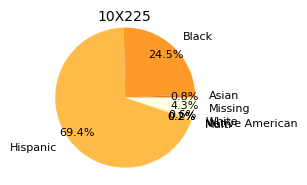

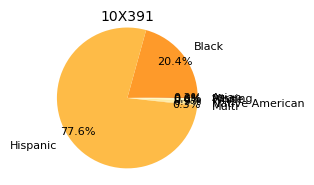

...

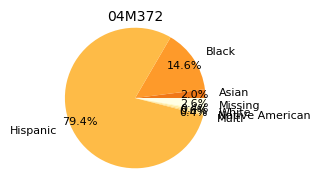

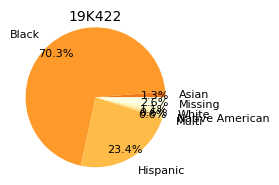

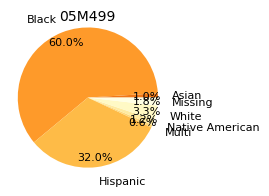

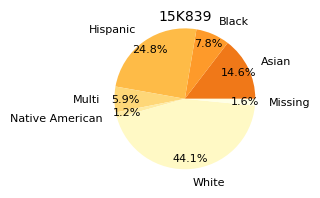

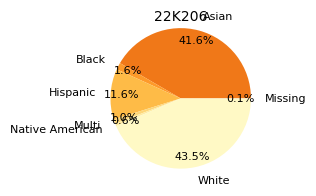

In [42]:
# Make piecharts for popups in the map and add them as columns to the mappable dataframe

# Initialize AVGDF_mappable_plots with the original DataFrame to preserve its content across merges
schools_mappable_plots = schoolsAllData_mappable.copy()

# list of schools names

schoolsNames = schoolsAllData_mappable['DBN'].to_list()

# Create disctionnary to hold the dataframes by schools
schoolDFs = {}

# Make dataframes by schools 
for name in schoolsNames:
    dfName = name
    schoolDFs[dfName] = schools_mappable_plots[schools_mappable_plots['DBN'] == name]

plots = []
plotsDFs = {}


columns_to_plot = ['% Asian', '% Black', '% Hispanic', '% Multi-Racial', '% Native American', '% White', '% Missing Race_Ethnicity Data']  
# Plot dataframes by school
for schoolDF, current_dataframe in schoolDFs.items():
    # schoolDF contains the name of the dataframe
    # current_dataframe contains the dataframe itself

        # Do something with current_dataframe
        # Create a plot
        fig = create_chart(current_dataframe, schoolDF, columns_to_plot)

        # Convert the plot to a PNG image and then encode it
        io_buf = BytesIO()
        fig.savefig(io_buf, format='png', bbox_inches='tight')
        io_buf.seek(0)
        base64_string = base64.b64encode(io_buf.read()).decode('utf8')

        pair = (schoolDF, base64_string)

        plots.append(pair)

# add the plots to the geodataframe of middle schools subject results 
plotsDFs = pd.DataFrame(plots, columns=['DBN', 'Dvst_chart'])
            

schools_mappable_plots = pd.merge(schools_mappable_plots, plotsDFs, left_on = 'DBN', right_on='DBN')
    
del schoolDFs, columns_to_plot, plotsDFs

In [43]:
schools_mappable_plots.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 472 entries, 0 to 471
Data columns (total 42 columns):
 #   Column                         Non-Null Count  Dtype   
---  ------                         --------------  -----   
 0   OBJECTID                       472 non-null    int64   
 1   LEGAL_NAME                     472 non-null    object  
 2   PHYSADDRLINE1                  472 non-null    object  
 3   PHYSCITY                       472 non-null    object  
 4   COUNTY_DESC                    472 non-null    object  
 5   RECORD_TYPE_DESC               472 non-null    object  
 6   SDL_DESC                       472 non-null    object  
 7   geometry                       472 non-null    geometry
 8   DBN                            472 non-null    object  
 9   School Name_x                  472 non-null    object  
 10  10yrs avg Lvl 1 Math           464 non-null    float64 
 11  10yrs avg Lvl 2 Math           464 non-null    float64 
 12  10yrs avg Lvl 3 Math        

C:\Users\Student\anaconda3\envs\AC37\lib\site-packages\pandas\plotting\_matplotlib\core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


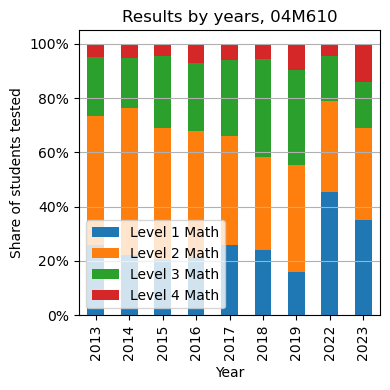

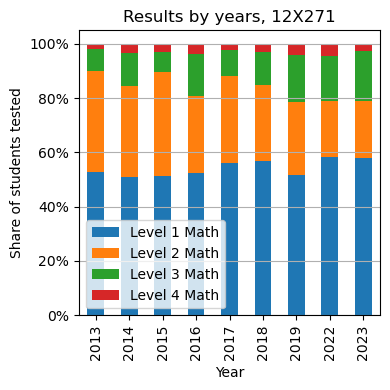

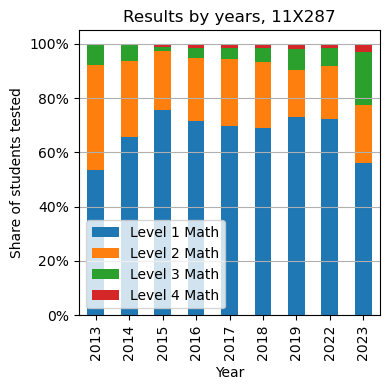

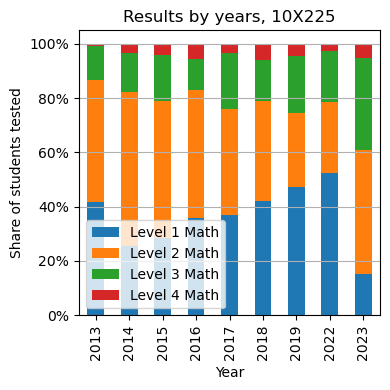

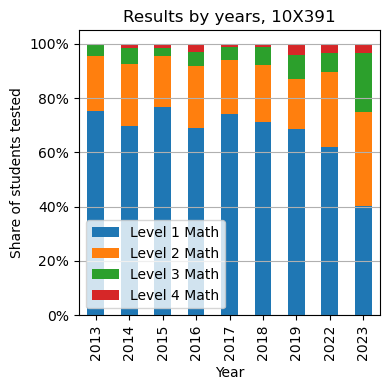

...

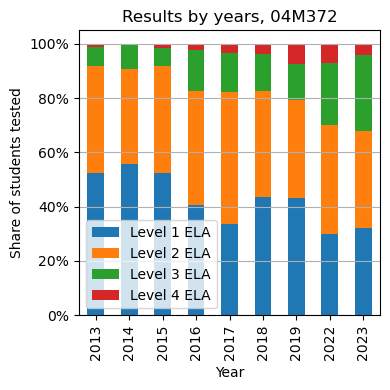

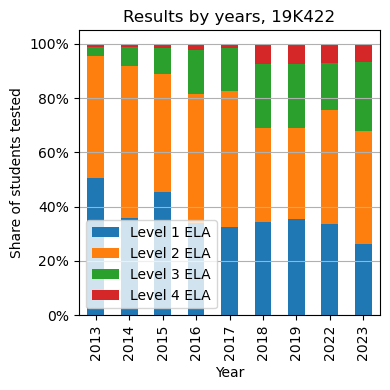

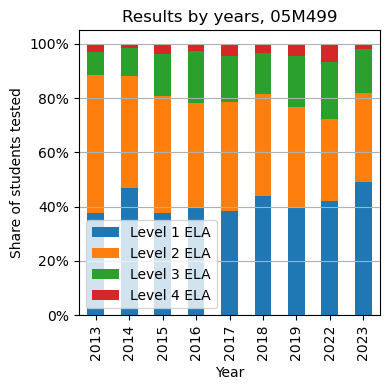

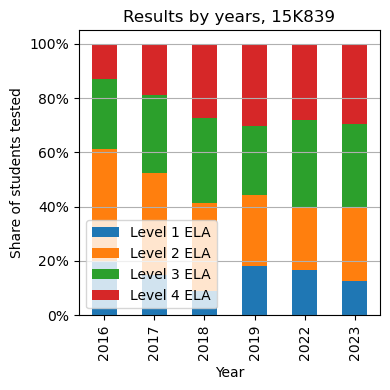

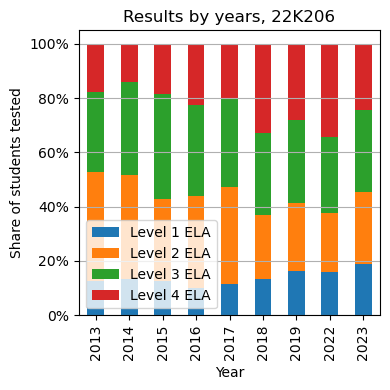

In [44]:
# Make plots for popups in the map and add them as columns to the mappable dataframe


# list of schools names

schoolsNames = schools_mappable_plots['DBN'].to_list()
testResults = allResultsDF

# Create disctionnary to hold the dataframes by schools
schoolDFs = {}

# Make dataframes by schools 
for name in schoolsNames:
    dfName = name
    schoolDFs[dfName] = testResults[testResults['DBN'] == name]

plots = []
plotsDFs = {}

for subject in subjects:
    columns_to_plot = [f"Level 1 {subject}", f"Level 2 {subject}", f"Level 3 {subject}", f"Level 4 {subject}"]  
    # Plot dataframes by school
    for schoolDF, current_dataframe in schoolDFs.items():
        # schoolDF contains the name of the dataframe
        # current_dataframe contains the dataframe itself

            # Do something with current_dataframe
            # Create a plot
            fig = create_plot(current_dataframe, schoolDF, columns_to_plot)

            # Convert the plot to a PNG image and then encode it
            io_buf = BytesIO()
            fig.savefig(io_buf, format='png', bbox_inches='tight')
            io_buf.seek(0)
            base64_string = base64.b64encode(io_buf.read()).decode('utf8')

            pair = (schoolDF, base64_string)

            plots.append(pair)

    # add the plots to the geodataframe of middle schools subject results 
    plotsDF = pd.DataFrame(plots, columns=['DBN', f'plot {subject}'])

    plotsDFs[subject] = plotsDF
            
for subject, df in plotsDFs.items():
    schools_mappable_plots = pd.merge(schools_mappable_plots, df, left_on = 'DBN', right_on='DBN')

In [45]:
fname = 'schoolDataPlots.geojson'
fpath = os.path.join(basePath, outputFolder, fname)
schools_mappable_plots.to_file(fpath, driver="GeoJSON")

del fname, fpath

In [46]:
schools_mappable_plots.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 944 entries, 0 to 943
Data columns (total 44 columns):
 #   Column                         Non-Null Count  Dtype   
---  ------                         --------------  -----   
 0   OBJECTID                       944 non-null    int64   
 1   LEGAL_NAME                     944 non-null    object  
 2   PHYSADDRLINE1                  944 non-null    object  
 3   PHYSCITY                       944 non-null    object  
 4   COUNTY_DESC                    944 non-null    object  
 5   RECORD_TYPE_DESC               944 non-null    object  
 6   SDL_DESC                       944 non-null    object  
 7   geometry                       944 non-null    geometry
 8   DBN                            944 non-null    object  
 9   School Name_x                  944 non-null    object  
 10  10yrs avg Lvl 1 Math           928 non-null    float64 
 11  10yrs avg Lvl 2 Math           928 non-null    float64 
 12  10yrs avg Lvl 3 Math        